<a href="https://colab.research.google.com/github/lisosoma/BI-statistics/blob/main/bi_hw2_9.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib
import numpy as np
import scipy.stats as sts
import scipy
import seaborn as sns
import scipy.optimize as opt
from scipy.optimize import fmin
import seaborn as sns

### Задача 1.

- (a)

$E Q_{inner} = (n − r)σ^2$

$E Q_{inner} = E\sum\limits_{i,j}(y_{ij} - \bar y_i)^2 = \sum\limits_{i,j} E(y_{ij} - \bar y_i)^2 = \sum\limits_{i,j} D(y_{ij} - \bar y_i) - E^2(y_{ij} - \bar y_i)$. 

Матожидание $E(y_{ij} - \bar y_i)$ равно нулю, значит $E Q_{inner} = \sum\limits_{i,j} D(y_{ij} - \bar y_i) = \sum\limits_{i,j} σ^2$. 

Поскольку у нас имеется $n$ элементов всего и $r$ групп, то всего независимых величин в данной сумме получится $n-r$. Значит данная сумма иммет распределение $\chi^2(n-r)$ и тогда $E Q_{inner} = (n − r)σ^2$, что и требовалось показать.

### Задача 2.

Смоделируйте выборку $Y$, зависящую от двух факторов: дифференциального фактора α принимающего 2 значения, и случайного фактора $β$ (пусть в вашей выборке он принимает 4 значения), где фактор $α$ значимо влияет на наблюдения, фактор $β$ незначимо, а межфакторные взаимодействия оказывают значимое воздействие. Проверьте гипотезы о значимости всех факторов.

Функция, которая генерирует матрицу плана для двухфакторного дисперсионного анализа:

In [ ]:
def matrix_plan_generate(m):
    # первый стоблец из единиц
    first = np.ones(np.sum(m))

    r = m.shape[0]
    s = m.shape[1]

    # создаем матрицу из нулей 
    matrix = np.zeros((np.sum(m), s + r + s*r))

    # создаем вспомогательные матрицы 
    # для заполнения блока альфа
    mmm = np.sum(m, axis = 1)
    mm = np.cumsum(mmm, axis=0)

    # заполняем блок альфа
    for j in range(mm[0]):
        matrix[j][0] = 1
    for i in range(1, r):
        for j in range(mmm[i]):
            matrix[j + mm[i-1]][i] = 1

    # создаем вспомогательные матрицы
    # для заполнения блока бета
    m_ = m.reshape(r * s)
    mm_ = np.cumsum(m_, axis=0)

    # заполняем блок бета
    for j in range(m_[0]):
        matrix[j][r] = 1
    for i in range(1, s * r):
        for j in range(m_[i]):
            matrix[j + mm_[i-1]][i % s + r] = 1

    # заполняем блок альфабет
    for j in range(m_[0]):
        matrix[j][r+s] = 1
    for i in range(1, s*r):
        for j in range(m_[i]):
            matrix[j + mm_[i-1]][i + s + r] = 1

    matrix = np.concatenate([[first], matrix.T], axis = 0).T

    return matrix

Сгенерируем матрицу плана.

In [ ]:
m = np.array([[10, 4, 9, 13], [15, 21, 7, 2]]) # матрица для генерации матрицы плана
planm = matrix_plan_generate(m) # матрица плана
alpha = np.array([1, 2]) # значения, которые принимает alpha
beta = np.array([0.1, 0.2, 0.3, 0.4]) # значения, которые принимает beta
alphabeta = np.concatenate([beta * 1, beta * 2]) # значения alphabeta
vector = np.concatenate([[1], alpha, np.zeros(4), alphabeta]) # вектор из всех коэффициентов

Сгенерируем выборку.

In [ ]:
Y = planm @ vector.T + sts.norm.rvs(size = np.sum(m))

Посчитаем вариации.

In [ ]:
y_mean = np.mean(Y)
Q_eps = np.sum((Y - planm @ vector.T) ** 2)

group1r, group2r = Y[:np.sum(m[0])], Y[np.sum(m[0]):]
y_mean1r, y_mean2r = np.mean(group1r), np.mean(group2r)

groups1 = np.concatenate([Y[:10], Y[36:36 + 15]])
groups2 = np.concatenate([Y[10:14], Y[36 + 15:36 + 36]])
groups3 = np.concatenate([Y[14:23], Y[36+ 36:36 + 43]])
groups4 = np.concatenate([Y[23:36], Y[43 + 36:]])
y_means1, y_means2, y_means3, y_means4 = np.mean(groups1), np.mean(groups2), np.mean(groups3), np.mean(groups4)

y_meanrs = [np.mean(Y[:rs[0]])]
for i in range(1, 8):
    y_meanrs.append(np.mean(Y[rs[i - 1]:rs[i]]))
    
Q_alphabeta = ((y_meanrs[0] - y_mean1r - y_means1 + y_mean) ** 2 +
               (y_meanrs[1] - y_mean1r - y_means2 + y_mean) ** 2 +
               (y_meanrs[2] - y_mean1r - y_means3 + y_mean) ** 2 +
               (y_meanrs[3] - y_mean1r - y_means4 + y_mean) ** 2 +
               (y_meanrs[4] - y_mean2r - y_means1 + y_mean) ** 2 +
               (y_meanrs[5] - y_mean2r - y_means2 + y_mean) ** 2 +
               (y_meanrs[6] - y_mean2r - y_means3 + y_mean) ** 2 +
               (y_meanrs[7] - y_mean2r - y_means4 + y_mean) ** 2)
    
Q_alpha = (y_mean1r - y_mean) ** 2 + (y_mean2r - y_mean) ** 2
Q_beta = (y_means1 - y_mean) ** 2 + (y_means2 - y_mean) ** 2 + (y_means3 - y_mean) ** 2 + (y_means4 - y_mean) ** 2

Посчитаем статистики критерия Фишера.

In [ ]:
F_alpha = 2 * 4 * (np.sum(m) - 1) / (2 - 1) * Q_alpha / Q_eps
F_beta = 2 * 4 * (np.sum(m) - 1) / (4 - 1) * Q_beta / Q_eps
F_alphabeta = 2 * 4 * (np.sum(m) - 1) / (4 - 1) / (2 - 1) * Q_alphabeta / Q_eps 

In [ ]:
if F_alpha < sts.f.ppf(0.95, (2 - 1), 2 * 4 * (np.sum(m) - 1)):
    print('Есть основания отклонить гипотезу о значимости фактора альфа с уровнем значимости 0.05')
else:
    print('Нет оснований отклонить гипотезу о значимости фактора альфа с уровнем значимости 0.05')
if F_beta < sts.f.ppf(0.95, (4 - 1), 2 * 4 * (np.sum(m) - 1)):
    print('Есть основания отклонить гипотезу о значимости фактора бета с уровнем значимости 0.05')
else:
    print('Нет оснований отклонить гипотезу о значимости фактора бета с уровнем значимости 0.05')
if F_alphabeta < sts.f.ppf(0.95, (4 - 1) * (2 - 1), 2 * 4 * (np.sum(m) - 1)):
    print('Есть основания отклонить гипотезу о значимости межфакторных взаимодействий с уровнем значимости 0.05')
else:
    print('Нет оснований отклонить гипотезу о значимости межфакторных взаимодействий с уровнем значимости 0.05')

Нет оснований отклонить гипотезу о значимости фактора альфа с уровнем значимости 0.05
Есть основания отклонить гипотезу о значимости фактора бета с уровнем значимости 0.05
Нет оснований отклонить гипотезу о значимости межфакторных взаимодействий с уровнем значимости 0.05


### Задача 3.

В этом задании вам требуется полностью проделать путь к применению однофакторного дисперсионного анализа: сперва проверка на нормальность, затем на равенство дисперсий, затем ANOVA и, наконец, если ANOVA отвергнет гипотезу о равенстве средних, применить тест Тьюки. Считайте, что выборка $Y$ объема 100 разбита на 4 подвыборки объема $25$ со следующими параметрами: $Y_1$ из распределения $\mathcal{N}(3 − ε; 1)$, $Y_2$ и $Y_3$ из распределения $\mathcal{N}(3; 1)$, и $Y_4$ из распределения $\mathcal{N}(3 + ε; 1)$. Вам требуется понять, как часто вся процедура будет выдавать неизвестный результат (отверглась гипотеза о нормальности или об одинаковости дисперсий), верный результат (ANOVA правильно отверг гипотезу о равенстве средних, а тест Тьюки сказал, что вторая и третья группы не отличаются, а все остальные различны) или неверный результат (любой иной вывод). Посмотрите, как меняется ответ при разных $ε$ из интервала $[0.2; 1]$.

Реализуем функцию, генерирующую выбобрку $Y$. Везде для проверки гипотез будем использовать уровень значимости $0.05$.

In [ ]:
def sample_generate(eps):
    y1 = sts.norm.rvs(loc = 3 - eps, scale = 1, size = 25)
    y2, y3 = sts.norm.rvs(loc = 3, scale = 1, size = 25), sts.norm.rvs(loc = 3, scale = 1, size = 25)
    y4 = sts.norm.rvs(loc = 3 + eps, scale = 1, size = 25)
    return np.concatenate([y1, y2, y3, y4])

Далее проведем $10000$ экспериментов для каждого значения $\varepsilon$, чтобы посмотреть, какие результаты выдает процедура. Значения для $\varepsilon$ будем брать с шагом $0.1$. Сгенерируем выборки.

In [ ]:
eps = np.linspace(0.2, 1, 9, endpoint = True)
samples = [[sample_generate(e) for i in range(10000)] for e in eps]

Проверим выборки на нормальность. Для этого будем использовать критерий Шапиро-Уилка. Сохраним в массив значения p-value.

In [ ]:
class graphics:
    def __init__(self, f):
        self.f = f 
    
    def eps(self):
        f = self.f
        colors = ['maroon', 'green']
        fig = plt.figure(figsize=(30, 90))
        for i in range(9):
            plt.subplot(9, 1, i + 1)
            e = float('{:.3f}'.format(eps[i]))
            plt.rcParams.update({'font.size': 20})
            plt.title(fr'$\varepsilon$ = {e}')
            plt.xlabel('number of sample', fontsize=20, color='green')
            plt.ylabel('p-value', fontsize=20, color='green')
            n1 = np.where(f[i] >= 0.05)[0]
            n2 = np.where(f[i] < 0.05)[0]
            true = f[i][n1]
            false = f[i][n2]
            plt.plot(n1, true, color=colors[1], linewidth = 0, marker = 'o', markersize = 5, markerfacecolor = colors[1],
                    markeredgecolor = 'limegreen', markeredgewidth = 1, label = 'not reject')
            plt.plot(n2, false, color=colors[0], linewidth = 0, marker = 'o', markersize = 5, markerfacecolor = colors[0],
                    markeredgecolor = 'indianred', markeredgewidth = 1, label = 'reject')
            plt.legend()
            plt.grid(True)
            
    def stat(self, title):
        f = self.f
        reject_number = []
        for i in range(9):
            reject_number.append(len(np.where(f[i] < 0.05)[0]))

        fig = plt.figure(figsize=(20, 8))
        plt.rcParams.update({'font.size': 20})
        plt.title(f'{title}')
        plt.ylabel('number of rejects', fontsize=20, color='green')
        plt.xlabel(fr'$\varepsilon$', fontsize=20, color='green')
        plt.plot(eps, reject_number, color='blue', linewidth = 1, marker = 'o', markersize = 10, markerfacecolor = 'blue',
                markeredgecolor = 'blue', markeredgewidth = 1)
        plt.grid(True)
        reject_number = np.array(reject_number)
        print(f'В среднем из 10000 экспериментов гипотеза отверглась {round(np.mean(reject_number))} раз.')    
        
    def tukey(self, i, t):
        f = self.f
        colors = ['maroon', 'green']
        fig = plt.figure(figsize=(30, 10))
        e = float('{:.3f}'.format(eps[i]))
        plt.rcParams.update({'font.size': 20})
        plt.title(fr'{t} $\varepsilon$ = {e}')
        plt.xlabel('number of sample', fontsize=20, color='green')
        plt.ylabel('p-value', fontsize=20, color='green')
        n1 = np.where(f >= 0.05)[0]
        n2 = np.where(f < 0.05)[0]
        true = f[n1]
        false = f[n2]
        plt.plot(n1, true, color=colors[1], linewidth = 0, marker = 'o', markersize = 5, markerfacecolor = colors[1],
                markeredgecolor = 'limegreen', markeredgewidth = 1, label = 'not reject')
        plt.plot(n2, false, color=colors[0], linewidth = 0, marker = 'o', markersize = 5, markerfacecolor = colors[0],
                markeredgecolor = 'indianred', markeredgewidth = 1, label = 'reject')
        plt.legend()
        plt.grid(True)
        
    def first_type_error(self):
        f = self.f
        reject_number = []
        for i in range(len(f)):
            reject_number.append(len(np.where(f[i] < 0.05)[0]))
        reject_number = np.array(reject_number)
        return reject_number  / len(f[0])
        
    def diff_sizes(self):
        f = self.f
        reject_number = []
        for i in range(10):
            reject_number.append(len(np.where(f[i] < 0.05)[0]))
        reject_number = np.array(reject_number)
        fig = plt.figure(figsize=(20, 8))
        plt.rcParams.update({'font.size': 20})
        plt.title('Изменение ошибки первого рода в зависимости от отношения объемов выборок')
        plt.ylabel('Вероятность ошибки первого рода', fontsize=20, color='green')
        plt.xlabel(fr'Отношение объемов выборок', fontsize=20, color='green')
        plt.plot((n + 100) / 100, reject_number / len(f[0]), color='blue', linewidth = 1, marker = 'o', markersize = 10, markerfacecolor = 'blue',
                markeredgecolor = 'blue', markeredgewidth = 1)
        plt.grid(True)
        reject_number = np.array(reject_number)
        print(f'В среднем из 1000 экспериментов гипотеза отверглась {round(np.mean(reject_number))} раз.')

In [ ]:
shapiros = np.array([[sts.shapiro(samples[i][j]).pvalue for j in range(10000)] for i in range(9)])

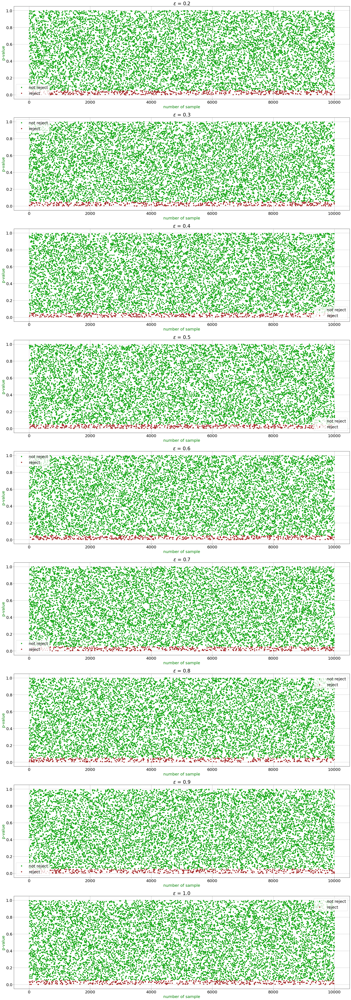

In [ ]:
shap = graphics(shapiros)
shap.eps()

В среднем из 10000 экспериментов гипотеза отверглась 466 раз.


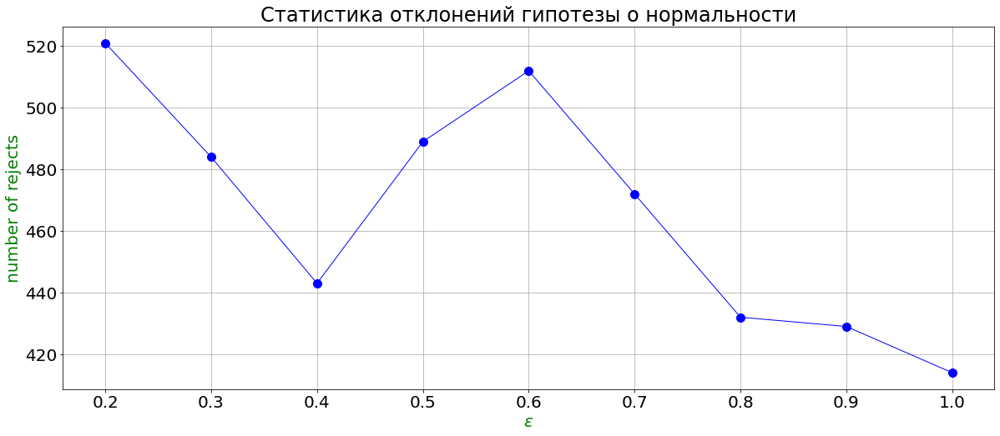

In [ ]:
shap.stat('Статистика отклонений гипотезы о нормальности')

Как видно из полученных графиков при разных значениях $\varepsilon$ количество отвергнутых гипотез о нормальности мало меняется. Посмотрим на это количество в зависимости от $\varepsilon$. Можно также отметить, что меньше всего гипотез было отклонено при значениях $\varepsilon$ близких к 1.

Теперь необходимо проверить гипотезу о равенстве дисперсий. Для этого будем использовать критерий Бартлетта.

In [ ]:
bartlett = np.array([[sts.bartlett(samples[i][j][0:24], samples[i][j][25:49], samples[i][j][50:74], samples[i][j][75:99]).pvalue for j in range(10000)] for i in range(9)])

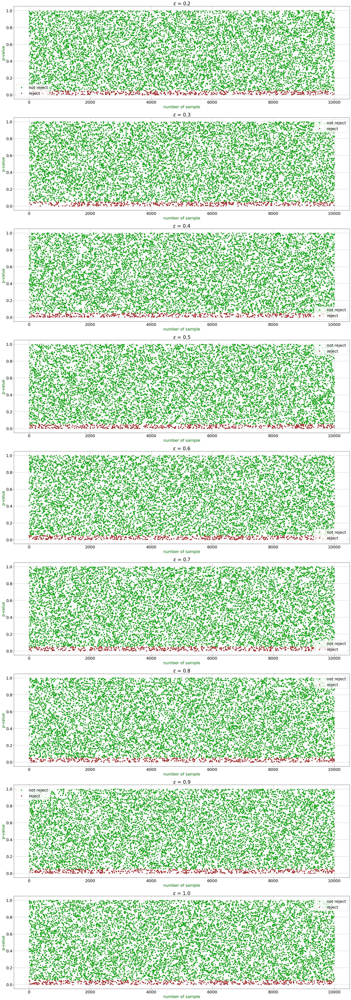

In [ ]:
bart = graphics(bartlett)
bart.eps()

В среднем из 10000 экспериментов гипотеза отверглась 508 раз.


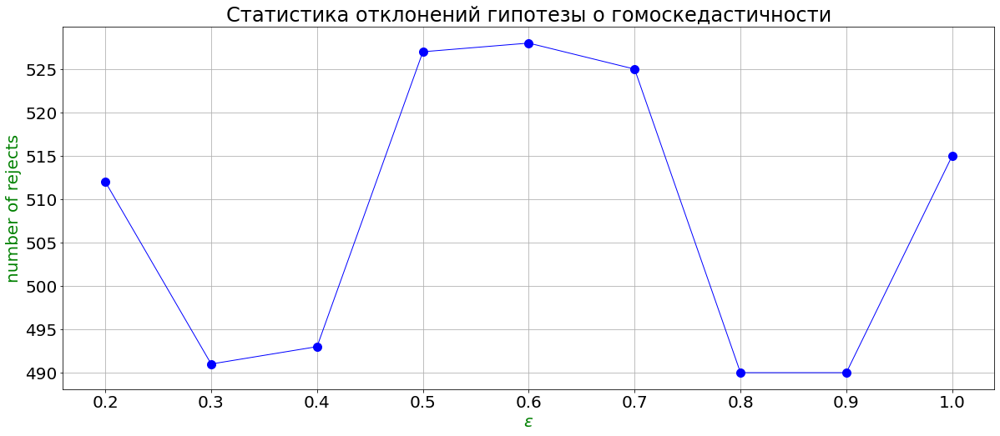

In [ ]:
bart.stat('Статистика отклонений гипотезы о гомоскедастичности')

In [ ]:
reject_number = np.array(reject_number)
print(f'В среднем из 10000 экспериментов гипотеза о гомоскедастичности отверглась {round(np.mean(reject_number))} раз.')

В среднем из 10000 экспериментов гипотеза о гомоскедастичности отверглась 508 раз.


Посчитаем, сколько раз суммарно тест на нормальность и тест на равенство дисперсий выдавали неверный результат.

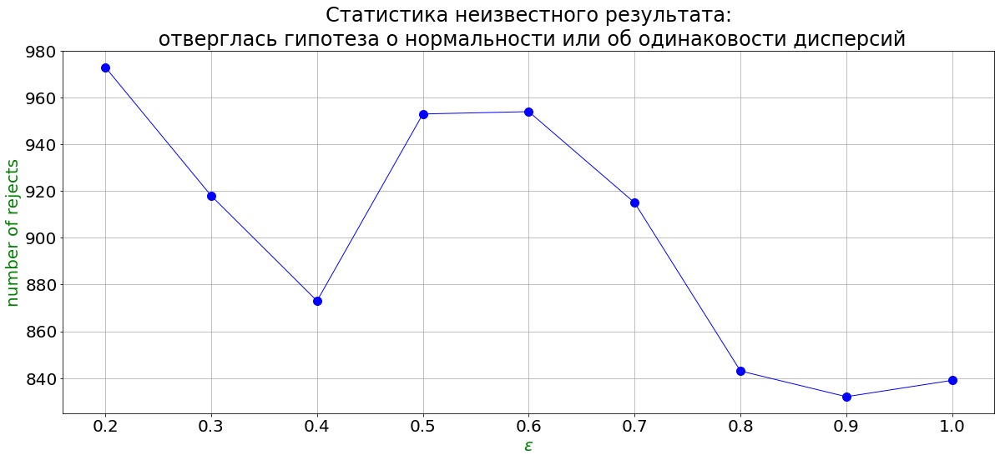

In [ ]:
n = []
for i in range(9):
    n1 = set(np.where(bartlett[i] < 0.05)[0])
    n2 = set(np.where(shapiros[i] < 0.05)[0])
    n.append(len(list(n1 | n2)))
    
fig = plt.figure(figsize=(20, 8))
plt.rcParams.update({'font.size': 20})
plt.title('Статистика неизвестного результата:\n отверглась гипотеза о нормальности или об одинаковости дисперсий')
plt.ylabel('number of rejects', fontsize=20, color='green')
plt.xlabel(fr'$\varepsilon$', fontsize=20, color='green')
plt.plot(eps, n, color='blue', linewidth = 1, marker = 'o', markersize = 10, markerfacecolor = 'blue',
        markeredgecolor = 'blue', markeredgewidth = 1)
plt.grid(True)

In [ ]:
n = np.array(n)
print(f'В среднем из 10000 экспериментов неизвестный результат был получен {round(np.mean(n))} раз.')

В среднем из 10000 экспериментов неизвестный результат был получен 900 раз.


Теперь с помощью ANOVA проверим гипотезу о равенстве средних.

In [ ]:
f_oneway = np.array([[sts.f_oneway(samples[i][j][0:24], samples[i][j][25:49], samples[i][j][50:74], samples[i][j][75:99]).pvalue for j in range(10000)] for i in range(9)])

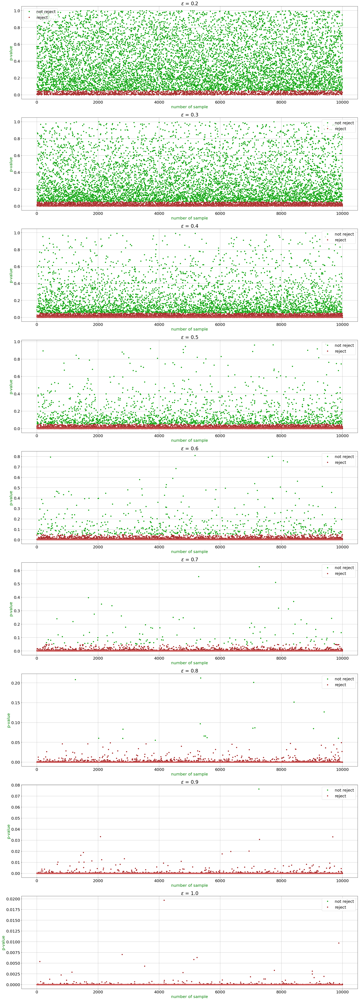

In [ ]:
anova = graphics(f_oneway)
anova.eps()

В среднем из 10000 экспериментов гипотеза отверглась 7675 раз.


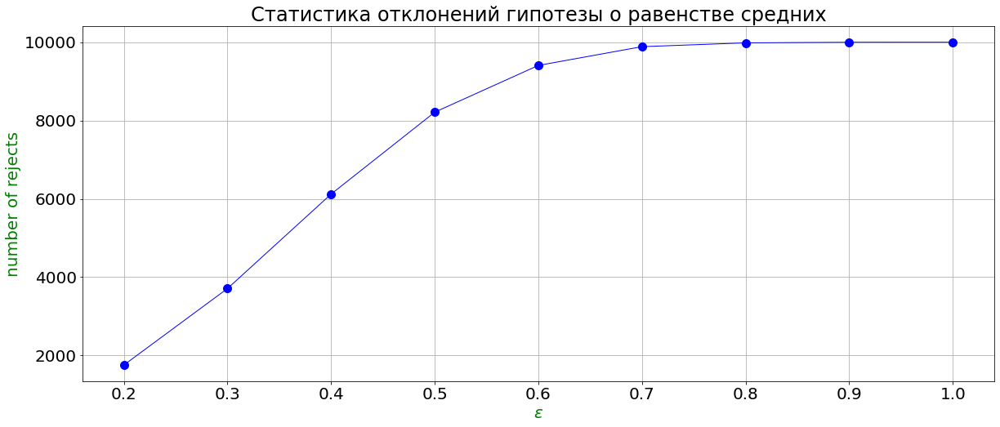

In [ ]:
anova.stat('Статистика отклонений гипотезы о равенстве средних')

Как видно, с увеличением $\varepsilon$ количество отклоненных гипотез растет и при $\varepsilon = 1$ достигает своего максимума.

Теперь применим тест Тьюки.

In [ ]:
from _hypotests import tukey_hsd

In [ ]:
from tqdm import tqdm

In [ ]:
tukey_hsd = np.array([[tukey_hsd(samples[i][j][0:24], samples[i][j][25:49], samples[i][j][50:74], samples[i][j][75:99]).pvalue for j in tqdm(range(10000))] for i in range(9)])

100%|██████████████████| 10000/10000 [30:16<00:00,  5.50it/s]


C:\Users\BEFB~1\AppData\Local\Temp/ipykernel_10076/1509701504.py:47: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(30, 10))


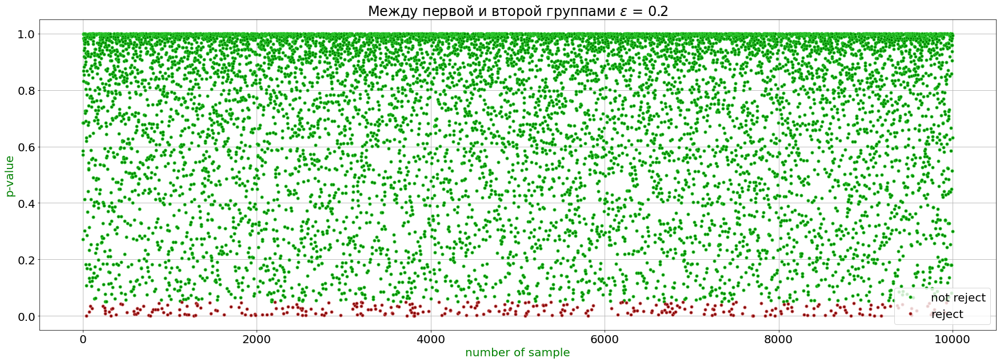

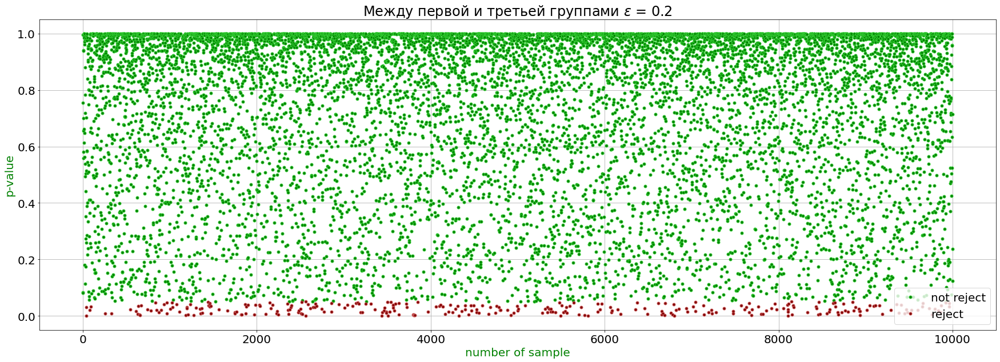

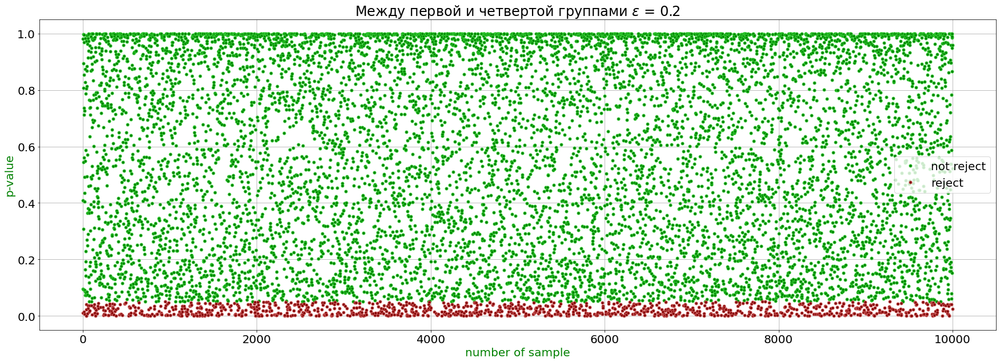

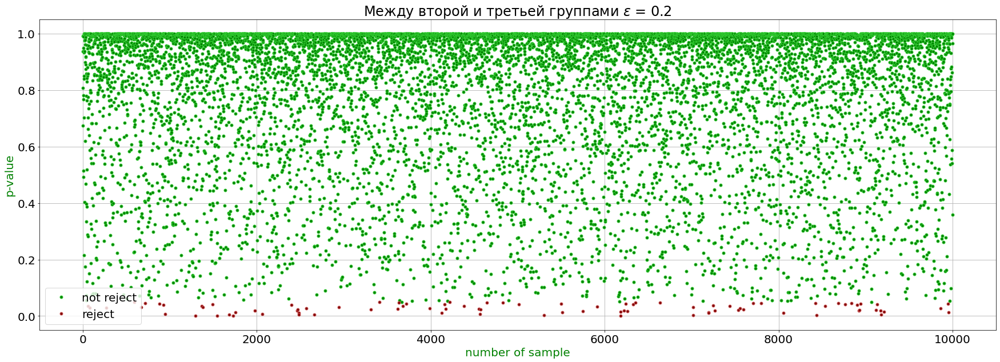

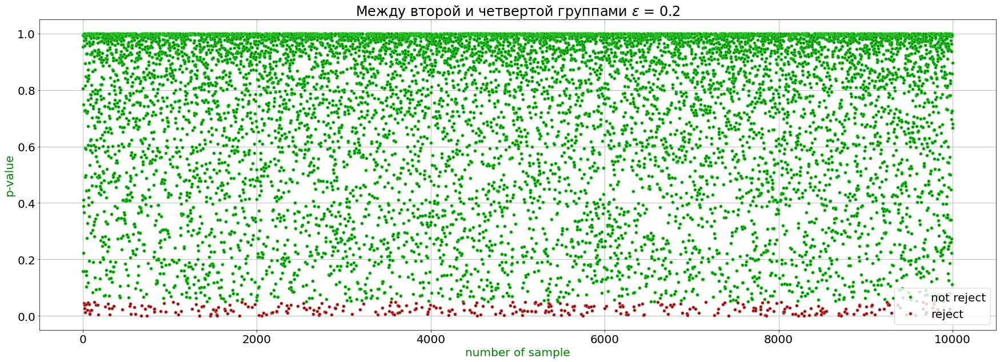

...

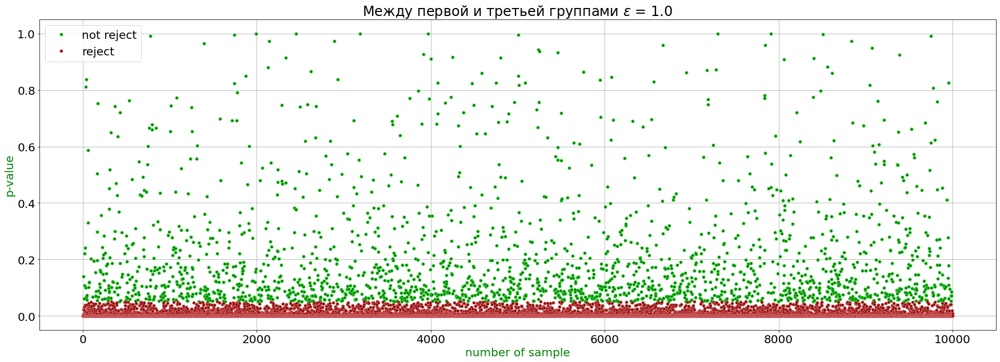

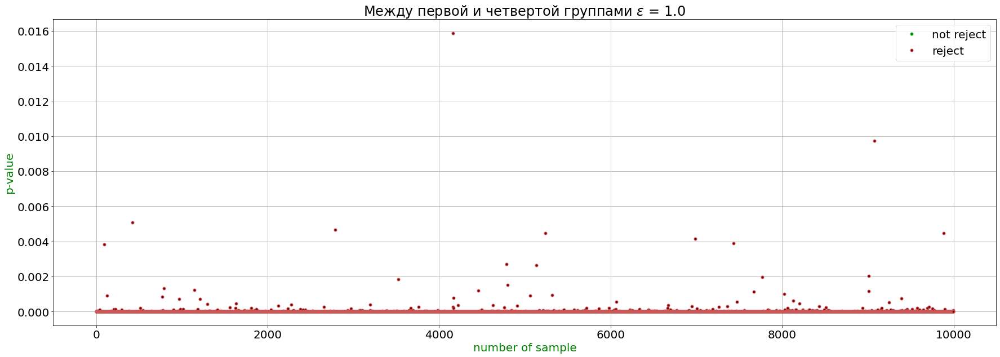

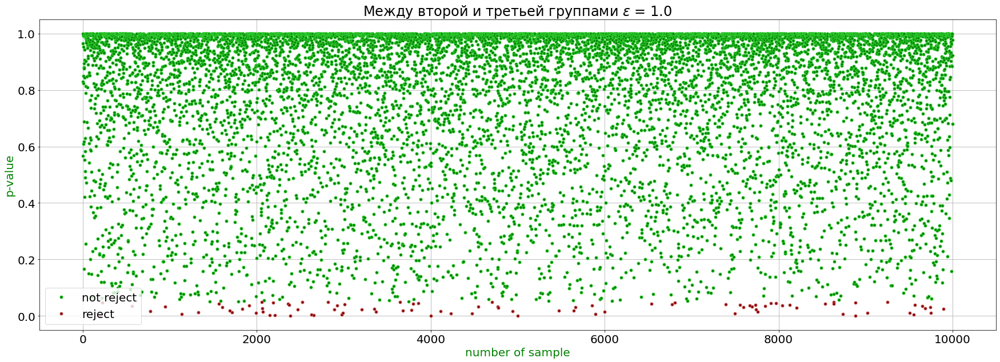

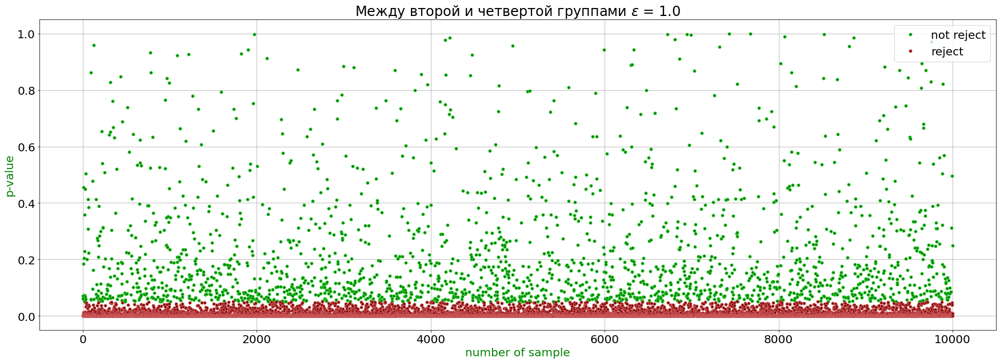

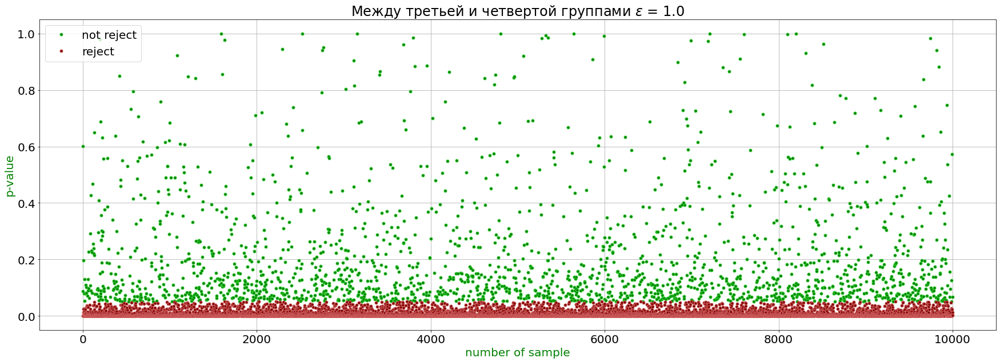

In [ ]:
f = tukey_hsd.reshape(9, 10000, 16)
numbers = [1, 2, 3, 6, 7, 11]
titles = ['Между первой и второй группами',
          'Между первой и третьей группами',
          'Между первой и четвертой группами',
          'Между второй и третьей группами',
          'Между второй и четвертой группами',
          'Между третьей и четвертой группами']

for i in range(len(f)):
    f_ = f[i].T
    for j in range(6):
        ff = graphics(f_[numbers[j]])
        ff.tukey(i, titles[j])

Как видно, с увеличением $\varepsilon$ становится все больше выборок, где равенство средних между второй и третьей группами не отклоняется и при этом появляется больше отклонений равенства средних между другими группами.

### Задача 4.

В этом задании вам требуется понять, насколько чувствителен дисперсионный анализ к различным отклонениям от модели.

- (a)

Отклонение от равных дисперсий. Рассмотрим однофакторную модель дисперсионного анализа с двумя группами. Посмотрите, как меняется ошибка первого рода в зависимости от отношения дисперсий в группах, от отношения объемов выборок и от общего объема выборки.

- (b)

Отклонение от нормальности. Выберите вашу любимую модель дисперсионного анализа (объемы всех подгрупп должны быть одинаковыми) и придумайте семейство непрерывных распределений $\{\mathcal F_{a,k}\}_{a,k}$, зависящее от двух параметров $a  ∈ [0; 5]$ и $k ∈ [−3; 3]$, с условиями

• математическое ожидание $\mathcal F_{a,k}$ равно 0;

• дисперсия $\mathcal F_{a,k}$ равна 1;

• ассиметрия $\mathcal F_{a,k}$ равна $a$;

• эксцесс $\mathcal F_{a,k}$ равен $k$;

• $\mathcal F_{0,0}$ = $\mathcal{N}(0; 1)$.

Используя $\mathcal F_{a,k}$ для генерации ваших подвыборок, посмотрите, как меняется ошибка первого рода в зависимости от $a, k$ и от общего объема выборки.

- (a) 

Модель однофакторного дисперсионного анализа имеет вид: $y_{ij} = β_0 + β_i + ε_{ij}$, $Y = Xβ + ε$ в матричном виде.

Сгенерируем выборки.

In [ ]:
eps = np.linspace(0, 2, 20, endpoint = True)
n = np.linspace(0, 1000, 10, endpoint = True, dtype = int)
samples = [[[np.concatenate([sts.norm.rvs(0, 2, size = 100), sts.norm.rvs(0, 2 + e, size = 100 + k)]) for i in range(1000)] for e in eps] for k in n]

Посмотрим, как меняется ошибка первого рода в зависимости от отношения дисперсий и отношения объемов выборок.

In [ ]:
f = []
for l in range(len(n)):
  f_oneway = np.array([[sts.f_oneway(samples[l][i][j][0:99], samples[l][i][j][100:199 + n[l]]).pvalue for j in range(100)] for i in range(len(eps))])
  f_one = graphics(f_oneway)
  f.append(f_one.first_type_error())

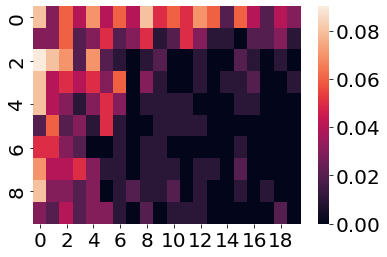

In [ ]:
sns.heatmap(f)

По горизонтали -- отношение объемов выборок (сверху отношение равно 1, снизу -- 11),  по вертикали -- отношение дисперсий (слева отношение равно 1, справа -- 2). Значения heatmap -- ошибка первого рода.

Уменьшим дисперсию, тогда максимальное отношение дисперсий справа на heatmap будет 10.

In [ ]:
eps = np.linspace(0, 1, 20, endpoint = True)
n = np.linspace(0, 1000, 10, endpoint = True, dtype = int)
samples = [[[np.concatenate([sts.norm.rvs(0, 0.1, size = 100), sts.norm.rvs(0, 0.1 + e, size = 100 + k)]) for i in range(1000)] for e in eps] for k in n]

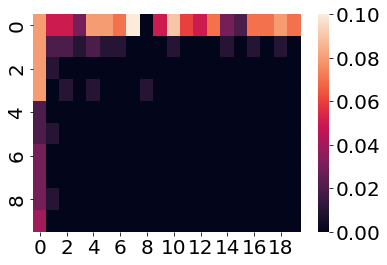

In [ ]:
f = []
for l in range(len(n)):
  f_oneway = np.array([[sts.f_oneway(samples[l][i][j][0:99], samples[l][i][j][100:199 + n[l]]).pvalue for j in range(100)] for i in range(len(eps))])
  f_one = graphics(f_oneway)
  f.append(f_one.first_type_error())
sns.heatmap(f)

Теперь сделаем максимальное отношение объемов выборок равным 100.

In [ ]:
eps = np.linspace(0, 0.2, 20, endpoint = True)
n = np.linspace(0, 10000, 10, endpoint = True, dtype = int)
samples = [[[np.concatenate([sts.norm.rvs(0, 0.1, size = 100), sts.norm.rvs(0, 0.1 + e, size = 100 + k)]) for i in range(1000)] for e in eps] for k in n]

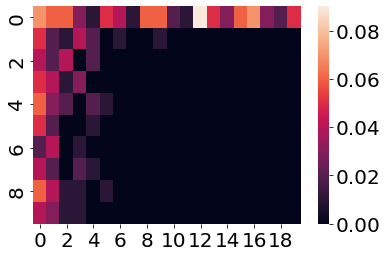

In [ ]:
f = []
for l in range(len(n)):
  f_oneway = np.array([[sts.f_oneway(samples[l][i][j][0:99], samples[l][i][j][100:199 + n[l]]).pvalue for j in range(100)] for i in range(len(eps))])
  f_one = graphics(f_oneway)
  f.append(f_one.first_type_error())
sns.heatmap(f)

- (b)

Поскольку $E(x) = 0$ и $D(x) = 1$, то коэффициент ассиметрии равен $\frac{E(x - E(x))^3}{1} = E(x^3) = a$ и коэффициент эксцесса равен $\frac{E(x - E(x))^4}{1} - 3 = E(x^4) -3 = k$ и $E(x^4) = k + 3$.

Необходимо найти такую плотность распределения $f(x)$, что $\int\limits_{-\infty}^{\infty}x^4f(x) = k + 3$, $\int\limits_{-\infty}^{\infty}x^3f(x) = a$ и также $\int\limits_{-\infty}^{\infty}xf(x) = 0$, $\int\limits_{-\infty}^{\infty}x^2f(x) = 1$. Еще необходимым условием является то, что при $k = a = 0$ функция распределения должна быть функцией распределения нормального распределения $\mathcal{N}(0, 1)$.

Можно придумать нечто следующее: $f(x) = p(x)\left(1 + \frac{a}{x^3} + \frac{k}{x^4}\right)$, где $p(x)$ -- плотность нормального распределения, но интеграл от такой функции, умноженной на $x^r$ не будет схоодящимся всегда. На этом идеи, к сожалению, закончились.